In [1]:
from srai.loaders.osm_loaders import OSMOnlineLoader
import geopandas as gpd
from shapely.geometry import Polygon, MultiPolygon
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

In [2]:
loader = OSMOnlineLoader()

osm_building_types = [
    "apartments",
    "bungalow",
    "cabin",
    "detached",
    "dormitory",
    "house",
    "residential",
    "semidetached_house",
    "terrace",
    "commercial",
    "industrial",
    "kiosk",
    "office",
    "retail",
    "supermarket",
    "warehouse",
    "church",
    "hospital",
    "school",
    "university",
    "public",
    "barn",
    "farm_auxiliary",
    "greenhouse",
    "stable",
    "garage",
    "shed",
    "hut",
    "boathouse",
    "bunker",
    "bridge",
    "tower",
]

osm_filter = {
    "building": osm_building_types,
    "building:levels": True,
}

In [3]:
gdf = gpd.read_file('data/shp/REJSTAT_20231231.shp')
gdf = gdf.to_crs(epsg=4326)
geometry = gdf.geometry.union_all()

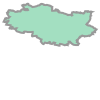

In [4]:
geometry

In [5]:
buildings = loader.load(geometry, osm_filter)

In [6]:
buildings

,geometry,building,building:levels
feature_id,,,
node/8401798757,POINT (17.0419 51.07872),residential,None
node/8432060525,POINT (17.04046 51.07763),residential,None
node/8468760968,POINT (17.03986 51.07893),residential,None
node/8468811205,POINT (17.04782 51.07968),residential,None
node/8486452597,POINT (17.03617 51.08098),residential,None
...,...,...,...
way/1348498273,"POLYGON ((17.00806 51.17733, 17.00807 51.1773,...",None,1
way/1348500445,"POLYGON ((17.00804 51.17704, 17.00814 51.17706...",None,1
way/1348500446,"POLYGON ((17.00808 51.17689, 17.00819 51.17691...",None,1


In [7]:
buildings['building'].value_counts(dropna=False)

building
None                  30438
apartments             7837
house                  3180
residential            3113
garage                 3070
detached               1063
retail                 1008
office                  516
industrial              436
warehouse               405
commercial              399
terrace                 369
semidetached_house      366
shed                    363
school                  325
greenhouse              251
university              235
church                  113
kiosk                    80
hospital                 78
hut                      69
bunker                   52
farm_auxiliary           50
dormitory                42
supermarket              22
stable                   16
public                    9
bungalow                  7
bridge                    6
tower                     3
barn                      2
boathouse                 1
cabin                     1
Name: count, dtype: int64

In [8]:
buildings['building'].fillna('unknown', inplace=True)

C:\Users\wikto\AppData\Local\Temp\ipykernel_22700\3412672453.py:1: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  buildings['building'].fillna('unknown', inplace=True)


In [9]:
building_to_category = {
    "apartments": "residential",
    "bungalow": "residential",
    "cabin": "residential",
    "detached": "residential",
    "dormitory": "residential",
    "house": "residential",
    "residential": "residential",
    "semidetached_house": "residential",
    "terrace": "residential",
    "kiosk": "shopping",
    "retail": "shopping",
    "supermarket": "shopping",
    "commercial": "work",
    "industrial": "work",
    "office": "work",
    "warehouse": "work",
    "public": "public",
    "church": "public",
    "hospital": "public",
    "school": "education",
    "university": "education",
    "barn": "other",
    "farm_auxiliary": "other",
    "greenhouse": "other",
    "stable": "other",
    "garage": "other",
    "shed": "other",
    "hut": "other",
    "boathouse": "other",
    "bunker": "other",
    "bridge": "other",
    "tower": "other",
    "unknown": "other"
}


In [10]:
buildings['category'] = buildings['building'].map(building_to_category)

In [11]:
buildings['category'].value_counts(dropna=False)

category
other          34321
residential    15978
work            1756
shopping        1110
education        560
public           200
Name: count, dtype: int64

In [12]:
categories = ['residential', 'work', 'shopping', 'education', 'public', 'other']

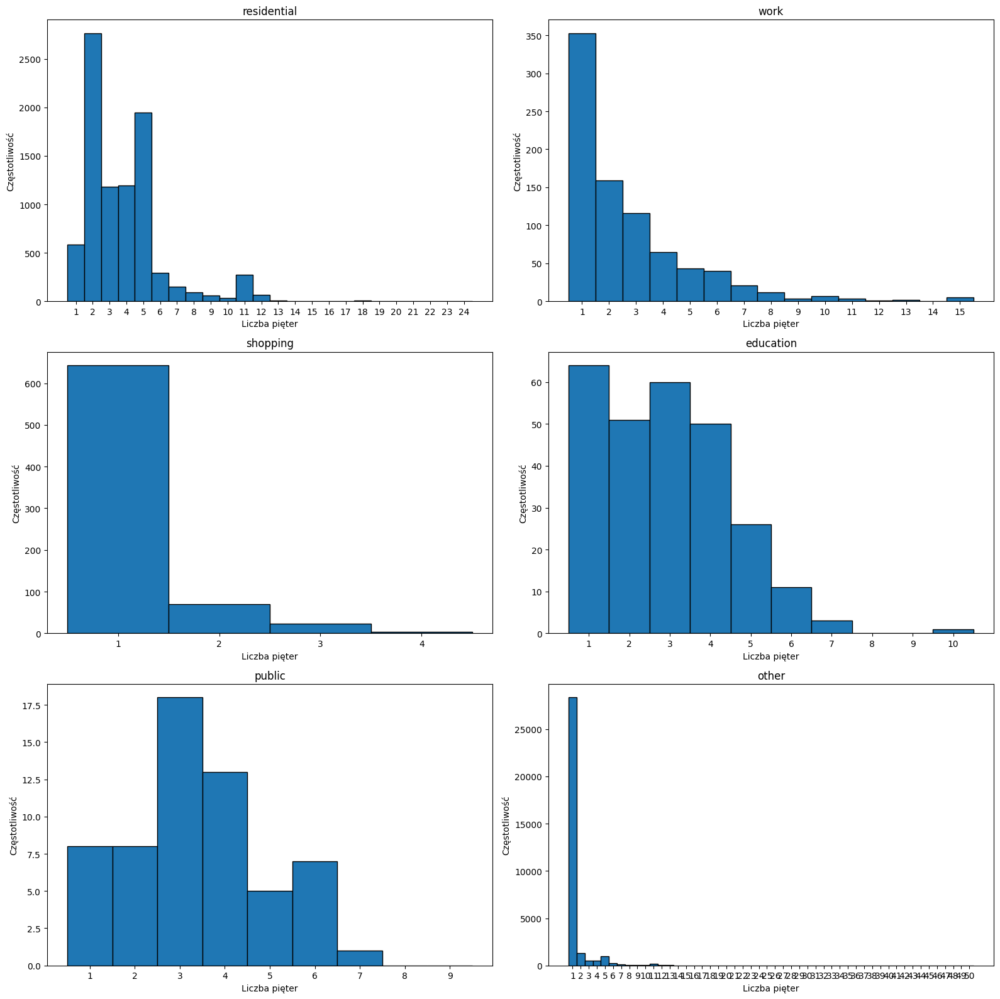

In [13]:
fig, axs = plt.subplots(3, 2, figsize=(16, 16))

for i, ax in enumerate(axs.flat):
    levels = pd.to_numeric(buildings[buildings['category'] == categories[i]]["building:levels"], errors="coerce").dropna().astype(int)
    ax.hist(levels, bins=np.arange(0.5, max(levels) + 0.5, 1), edgecolor='black')
    ax.set_title(categories[i])
    ax.set_xlabel('Liczba pięter')
    ax.set_ylabel('Częstotliwość')
    ax.set_xticks(np.arange(1, max(levels), 1))

plt.tight_layout()
plt.show()

In [14]:
medians = {cat: int(np.median(pd.to_numeric(buildings[buildings['category'] == cat]["building:levels"], errors="coerce").dropna())) for cat in categories}
medians

{'residential': 3,
 'work': 2,
 'shopping': 1,
 'education': 3,
 'public': 3,
 'other': 1}

In [15]:
buildings['building:levels'].fillna(buildings['category'].map(medians), inplace=True)
buildings

C:\Users\wikto\AppData\Local\Temp\ipykernel_22700\479323660.py:1: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  buildings['building:levels'].fillna(buildings['category'].map(medians), inplace=True)


,geometry,building,building:levels,category
feature_id,,,,
node/8401798757,POINT (17.0419 51.07872),residential,3,residential
node/8432060525,POINT (17.04046 51.07763),residential,3,residential
node/8468760968,POINT (17.03986 51.07893),residential,3,residential
node/8468811205,POINT (17.04782 51.07968),residential,3,residential
node/8486452597,POINT (17.03617 51.08098),residential,3,residential
...,...,...,...,...
way/1348498273,"POLYGON ((17.00806 51.17733, 17.00807 51.1773,...",unknown,1,other
way/1348500445,"POLYGON ((17.00804 51.17704, 17.00814 51.17706...",unknown,1,other
way/1348500446,"POLYGON ((17.00808 51.17689, 17.00819 51.17691...",unknown,1,other


In [16]:
buildings = buildings.to_crs(epsg=2180)
buildings = buildings[buildings.area != 0]
buildings['area'] = buildings.area * pd.to_numeric(buildings["building:levels"], errors="coerce")
buildings

,geometry,building,building:levels,category,area
feature_id,,,,,
relation/1438810,"POLYGON ((359209.483 357497.559, 359211.127 35...",apartments,5,residential,3300.531460
relation/1438816,"POLYGON ((366600.904 357415.519, 366628.015 35...",industrial,2,work,3172.953722
relation/1438819,"POLYGON ((361169.222 355607.343, 361211.811 35...",apartments,3,residential,6033.359291
relation/1438824,"POLYGON ((362223.545 357517.581, 362220.076 35...",residential,3,residential,828.420759
relation/1439766,"POLYGON ((362073.648 358359.084, 362064.603 35...",hospital,4,public,22882.427732
...,...,...,...,...,...
way/1348498273,"POLYGON ((360807.348 369729.014, 360807.96 369...",unknown,1,other,13.183798
way/1348500445,"POLYGON ((360805.282 369697.133, 360812.611 36...",unknown,1,other,4.437763
way/1348500446,"POLYGON ((360807.824 369680.267, 360815.147 36...",unknown,1,other,4.501201


In [17]:
buildings = buildings[buildings['category'] != 'other']
buildings

,geometry,building,building:levels,category,area
feature_id,,,,,
relation/1438810,"POLYGON ((359209.483 357497.559, 359211.127 35...",apartments,5,residential,3300.531460
relation/1438816,"POLYGON ((366600.904 357415.519, 366628.015 35...",industrial,2,work,3172.953722
relation/1438819,"POLYGON ((361169.222 355607.343, 361211.811 35...",apartments,3,residential,6033.359291
relation/1438824,"POLYGON ((362223.545 357517.581, 362220.076 35...",residential,3,residential,828.420759
relation/1439766,"POLYGON ((362073.648 358359.084, 362064.603 35...",hospital,4,public,22882.427732
...,...,...,...,...,...
way/1342260364,"POLYGON ((358056.202 365197.39, 358047.876 365...",apartments,3,residential,733.111941
way/1343906224,"POLYGON ((361607.934 359022.074, 361621.589 35...",apartments,3,residential,7748.192067
way/1346943158,"POLYGON ((358742.156 357660.424, 358824.875 35...",apartments,4,residential,2977.495629


In [18]:
buildings.explore(column='category', cmap='plasma', legend=True)

In [19]:
gdf.explore()

In [20]:
import geopandas as gpd
import numpy as np
from sklearn.cluster import AgglomerativeClustering
from shapely.geometry import Point

gdf = gdf.to_crs(epsg=2180)
gdf['centroid'] = gdf.geometry.centroid
coords = np.array([[point.x, point.y] for point in gdf['centroid']])
gdf['area'] = gdf.geometry.area
n_clusters = 10
clustering = AgglomerativeClustering(n_clusters=n_clusters, linkage='ward').fit(coords)
gdf['cluster'] = clustering.labels_
regions = gdf.dissolve(by='cluster', aggfunc={'area': 'sum'})

regions.explore(column='area')


In [21]:
regions = gpd.read_file('data/shp2/GraniceOsiedli.shp').to_crs(epsg=2180)

In [ ]:
gdf['position'] = gdf.geometry.centroid
centroids = gpd.GeoDataFrame(gdf[['position']], geometry='position', crs=gdf.crs)
result = gpd.sjoin(centroids, regions, how='left', predicate='within')
gdf['region'] = result['NAZWAOSIED']

In [23]:
buildings['position'] = buildings.geometry.centroid
centroids = gpd.GeoDataFrame(buildings[['position']], geometry='position', crs=buildings.crs)
result = gpd.sjoin(centroids, gdf, how='left', predicate='within')
buildings['region'] = result['REJON']
buildings['region_name'] = result['region']

c:\Studia\.conda\Lib\site-packages\geopandas\geodataframe.py:1819: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
c:\Studia\.conda\Lib\site-packages\geopandas\geodataframe.py:1819: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
c:\Studia\.conda\Lib\site-packages\geopandas\geodataframe.py:1819: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See th

In [24]:
buildings

,geometry,building,building:levels,category,area,position,region,region_name
feature_id,,,,,,,,
relation/1438810,"POLYGON ((359209.483 357497.559, 359211.127 35...",apartments,5,residential,3300.531460,POINT (359211.507 357481.131),932103,Krzyki - Partynice
relation/1438816,"POLYGON ((366600.904 357415.519, 366628.015 35...",industrial,2,work,3172.953722,POINT (366629.151 357405.912),932071,Księże
relation/1438819,"POLYGON ((361169.222 355607.343, 361211.811 35...",apartments,3,residential,6033.359291,POINT (361172.335 355565.905),932172,Ołtaszyn
relation/1438824,"POLYGON ((362223.545 357517.581, 362220.076 35...",residential,3,residential,828.420759,POINT (362212.39 357511.285),932191,Wojszyce
relation/1439766,"POLYGON ((362073.648 358359.084, 362064.603 35...",hospital,4,public,22882.427732,POINT (362027.653 358345.919),931972,Gaj
...,...,...,...,...,...,...,...,...
way/1342260364,"POLYGON ((358056.202 365197.39, 358047.876 365...",apartments,3,residential,733.111941,POINT (358046.892 365202.357),930214,Pilczyce - Kozanów - Popowice Płn.
way/1343906224,"POLYGON ((361607.934 359022.074, 361621.589 35...",apartments,3,residential,7748.192067,POINT (361625.028 359065.678),931972,Gaj
way/1346943158,"POLYGON ((358742.156 357660.424, 358824.875 35...",apartments,4,residential,2977.495629,POINT (358782.898 357649.884),932112,Klecina


In [25]:
buildings.explore(column='region_name')

In [28]:
category_area = buildings.groupby(['region_name', 'category'])['area'].sum().reset_index()

total_area = buildings.groupby(['region_name'])['area'].sum().reset_index()
total_area = total_area.rename(columns={'area': 'total_area'})

merged = pd.merge(category_area, total_area, on='region_name')

merged['percent_share'] = (merged['area'] / merged['total_area']) * 100

pivot_df = merged.pivot_table(index='region_name', columns='category', values='percent_share', fill_value=0)
pivot_df = pivot_df[categories[:-1]]
pivot_df

category,residential,work,shopping,education,public
region_name,,,,,
Bieńkowice,58.796764,41.203236,0.000000,0.000000,0.000000
Biskupin - Sępolno - Dąbie - Bartoszowice,85.659315,1.588559,1.446096,9.568784,1.737245
Borek,57.691684,11.209532,17.943775,3.963168,9.191841
Brochów,87.466903,4.794865,4.754736,0.000000,2.983497
Gaj,70.830051,2.642486,4.721548,3.929399,17.876516
Gajowice,91.154911,2.509544,2.305337,3.206273,0.823935
Grabiszyn - Grabiszynek,73.038736,12.842012,2.978949,10.621416,0.518887
Gądów - Popowice Płd.,51.985079,28.461541,16.276457,2.058957,1.217967
Huby,56.562340,8.923716,24.316455,7.489976,2.707513
